# Image Similarity and Clustering of Street Artwork
#### Author: Antonio Rueda-Toicen
#### [Berlin Computer Vision Group](https://www.meetup.com/berlin-computer-vision-group/)

**antonio.rueda.toicen 'at' gmail 'dot' com**

[![Creative Commons License](https://i.creativecommons.org/l/by/4.0/88x31.png)](http://creativecommons.org/licenses/by/4.0/)

This work is licensed under a [Creative Commons Attribution 4.0 International License](http://creativecommons.org/licenses/by/4.0/).

This tutorial is part 2 of a series on image similarity. Refer to the [previous notebook](https://colab.research.google.com/drive/1yR4e3OVXe_QqCIYkmDhcT75300P9Db1H#scrollTo=c8520ef2) to get the image embeddings.

The folder with the downloaded images is available [here](https://drive.google.com/drive/folders/1l7VvTnRwWpo4_wPPMrUcmMtKeaxuFTfY?usp=drive_link). Right click on the folder name and select "Add Shortcut to Drive" in order to add to your own Drive.


## Intro

Image embeddings, similarity metrics, and clustering on it are powerful techniques used in various domains, including **image analysis, recommendation systems, and data cleaning**. In this notebook, we'll explore how to use image similarity metrics to analyze and clean a dataset of artworks.

### Image Similarity
Image similarity measures how alike two images are and can be used to identify duplicates, variations, or related works within a dataset. It's an important step in preparing a clean and coherent dataset for further analysis or machine learning tasks. When building machine learning models, it's particularly important for us to eliminate duplicates between test and training sets, as this creates issues with [data leakage](https://en.wikipedia.org/wiki/Leakage_(machine_learning)#:~:text=In%20statistics%20and%20machine%20learning,when%20run%20in%20a%20production), meaning that we can't trust the accuracy that the model reports.

### Image Clustering
Image clustering groups similar images together, creating clusters of related content. It helps in understanding the underlying patterns, themes, or categories within a dataset. Clustering can reveal insights into the artistic styles, subjects, or other common features among the images.

### K-Medoids Algorithm
In this notebook, we'll use the [k-medoids algorithm](https://en.wikipedia.org/wiki/K-medoids), a robust clustering method that partitions the dataset into 'k' clusters. Unlike [k-means](https://en.wikipedia.org/wiki/K-means_clustering), k-medoids choose actual data points as cluster centers (medoids), making it less sensitive to outliers.

As the medoids are actual data points, they are the representatives of their clusters.

The animation below shows how the K-medoids algorithm converges to a solution.


![](https://upload.wikimedia.org/wikipedia/commons/e/e1/K-Medoids_Clustering.gif)

We'll apply k-medoids to explore the dataset and find the most representative works of the artist Bansky.

Let's dive into the process and begin with mounting Google Drive to access the necessary files.

## 1. Mounting Google Drive

In this section, we mount Google Drive to the Colab environment. This allows us to access files and data stored in Google Drive, which is essential if we are working with datasets or other resources stored there.

In [1]:
from google.colab import drive
drive.mount('/gdrive')

Mounted at /gdrive


## 2. Importing Libraries and Setting Paths

We begin by importing the necessary libraries that enable us to handle images, perform clustering, and conduct other related tasks. Next, we define the paths to the folders containing the images and data we will work with. Organizing paths helps us manage files efficiently.

In [2]:
# We use pathlib to ease the manipulation of filenames and paths in Google Drive
import os
from pathlib import Path

## 3. Reading and Validating Files

In this part, we read the necessary files, including image embeddings, and validate them to ensure that they are in the correct format. Validation helps in detecting and handling potential issues early in the process.

In [3]:
path = Path('/gdrive/MyDrive/art_recommendation')
artist = 'banksy'
folder_path = path / artist
os.listdir(folder_path)

['urls.txt', 'paintings', 'paintings_embeddings.pickle']

In [4]:
import pickle
with open(folder_path / 'paintings_embeddings.pickle', 'rb') as handle:
  paintings_embeddings = pickle.load(handle)

In [5]:
len(paintings_embeddings)

318

In [6]:
list_of_painting_names = os.listdir(folder_path / 'paintings')
# Check that we can read the proper paths to the images
full_paths_to_images = [folder_path / 'paintings' / painting for painting in list_of_painting_names ]
full_paths_to_images

[PosixPath('/gdrive/MyDrive/art_recommendation/banksy/paintings/banksy_02.jpg'),
 PosixPath('/gdrive/MyDrive/art_recommendation/banksy/paintings/banksy_04.jpg'),
 PosixPath('/gdrive/MyDrive/art_recommendation/banksy/paintings/banksy_05.jpg'),
 PosixPath('/gdrive/MyDrive/art_recommendation/banksy/paintings/banksy_06.jpg'),
 PosixPath('/gdrive/MyDrive/art_recommendation/banksy/paintings/banksy_07.jpg'),
 PosixPath('/gdrive/MyDrive/art_recommendation/banksy/paintings/banksy_08.jpg'),
 PosixPath('/gdrive/MyDrive/art_recommendation/banksy/paintings/banksy_010.jpg'),
 PosixPath('/gdrive/MyDrive/art_recommendation/banksy/paintings/banksy_011.jpg'),
 PosixPath('/gdrive/MyDrive/art_recommendation/banksy/paintings/banksy_012.jpg'),
 PosixPath('/gdrive/MyDrive/art_recommendation/banksy/paintings/banksy_013.jpg'),
 PosixPath('/gdrive/MyDrive/art_recommendation/banksy/paintings/banksy_014.jpg'),
 PosixPath('/gdrive/MyDrive/art_recommendation/banksy/paintings/banksy_015.jpg'),
 PosixPath('/gdrive/My

In [7]:
# Check the individual file names
os.listdir(folder_path / 'paintings')

['banksy_02.jpg',
 'banksy_04.jpg',
 'banksy_05.jpg',
 'banksy_06.jpg',
 'banksy_07.jpg',
 'banksy_08.jpg',
 'banksy_010.jpg',
 'banksy_011.jpg',
 'banksy_012.jpg',
 'banksy_013.jpg',
 'banksy_014.jpg',
 'banksy_015.jpg',
 'banksy_016.jpg',
 'banksy_017.jpg',
 'banksy_018.jpg',
 'banksy_019.jpg',
 'banksy_021.jpg',
 'banksy_022.jpg',
 'banksy_023.jpg',
 'banksy_025.jpg',
 'banksy_026.jpg',
 'banksy_028.jpg',
 'banksy_029.jpg',
 'banksy_1.jpg',
 'banksy_030.jpg',
 'banksy_032.jpg',
 'banksy_033.jpg',
 'banksy_034.jpg',
 'banksy_035.jpg',
 'banksy_036.jpg',
 'banksy_037.jpg',
 'banksy_038.jpg',
 'banksy_039.jpg',
 'banksy_041.jpg',
 'banksy_042.jpg',
 'banksy_043.jpg',
 'banksy_044.jpg',
 'banksy_047.jpg',
 'banksy_048.jpg',
 'banksy_049.jpg',
 'banksy_050.jpg',
 'banksy_051.jpg',
 'banksy_052.jpg',
 'banksy_054.jpg',
 'banksy_055.jpg',
 'banksy_056.jpg',
 'banksy_058.jpg',
 'banksy_059.jpg',
 'banksy_061.jpg',
 'banksy_062.jpg',
 'banksy_063.jpg',
 'banksy_064.jpg',
 'banksy_065.jpg',
 

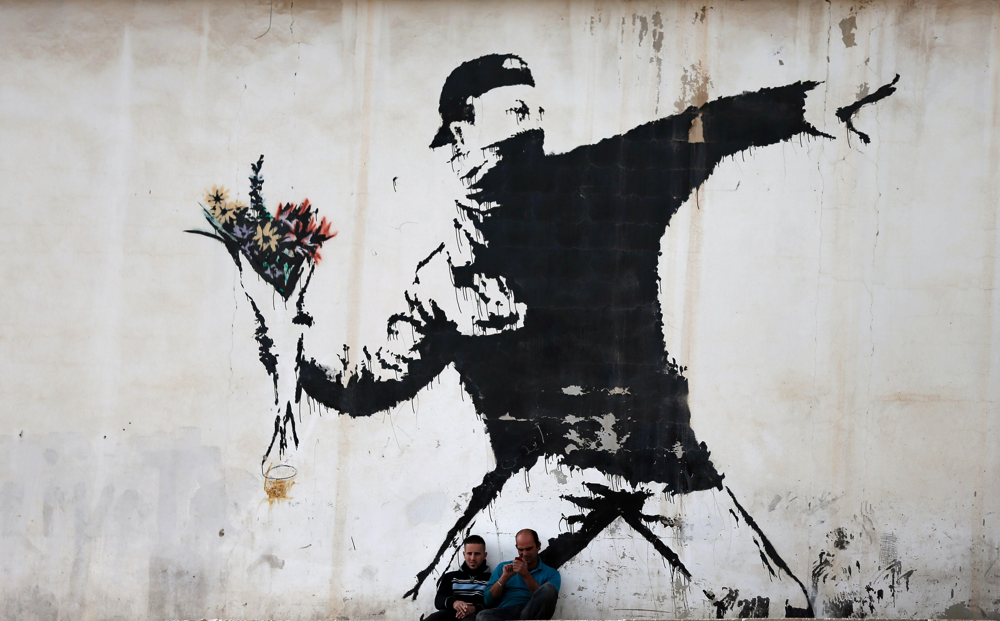

In [8]:
# Check that we can open a particular image from Google Drive
from PIL import Image
Image.open(full_paths_to_images[0])

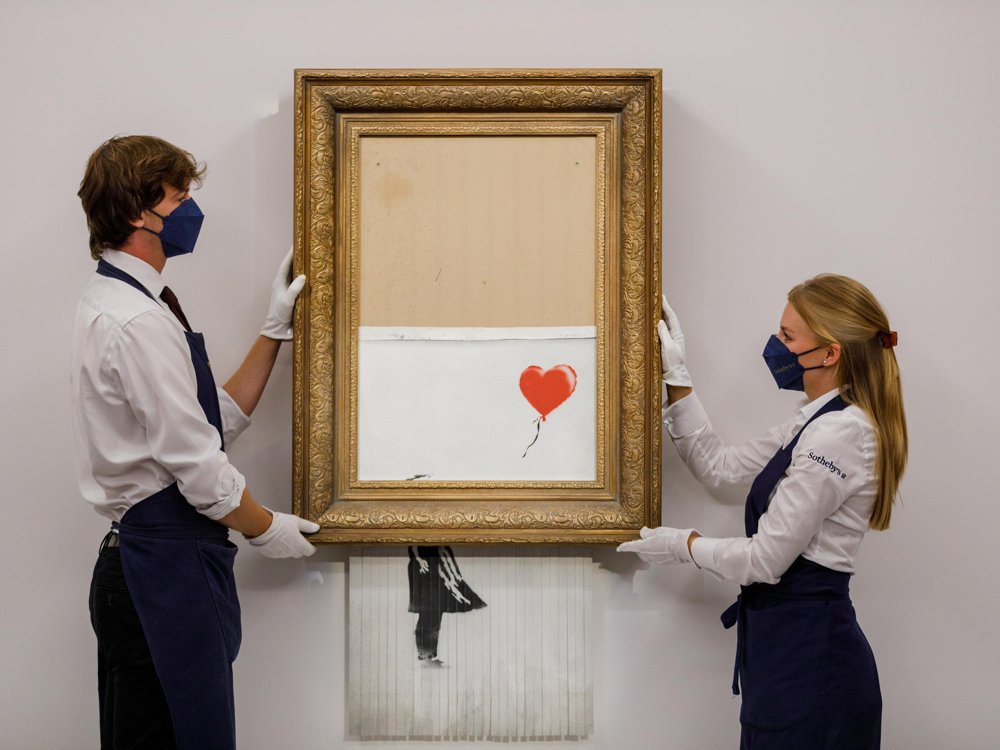

In [9]:
# Check that the keys of the dictionary contain image paths
Image.open(list(paintings_embeddings.keys())[0])

In [10]:
# Check the number of paintings in our dataset
paintings_to_visualize = {painting:embedding for painting, embedding in paintings_embeddings.items() if painting in full_paths_to_images}
len(paintings_to_visualize)

318

## Visualize Pairs


Visualizing pairs of images can provide insights into the similarities and differences between them. This step often helps in understanding the characteristics of the images and how they relate to each other.

In [11]:
import matplotlib.pyplot as plt
import numpy as np
import skimage.io as io
from numpy import dot
from numpy.linalg import norm

def cosine_similarity(a, b):
  return dot(a, b)/(norm(a)*norm(b))

def print_cosine_similarity(embedding_a, embedding_b):
  cos = cosine_similarity(embedding_a, embedding_b)
  result = f'Cosine similarity = {cos:.2f}'
  print(result)

def show_pair(imag_a, imag_b):
  plt.subplot(121)
  plt.imshow(np.array(imag_a))
  plt.axis("off")

  plt.subplot(122)
  plt.imshow(np.array(imag_b))
  plt.axis("off")

In [12]:
len(paintings_to_visualize)

318

Cosine similarity = 0.68


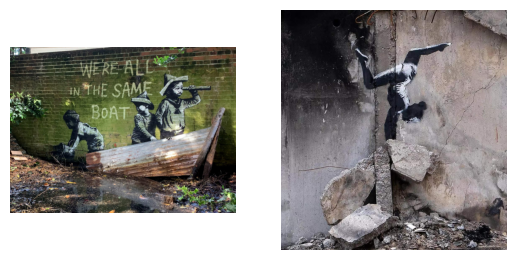

In [13]:
# We create double slider to visualize the similarity between every two images
# in the dataset
image_index_a = 221  #@param {type: "slider", min: 0, max: 317, step:1}

image_index_b = 61  #@param {type: "slider", min: 0, max: 317, step:1}

embed_a = list(paintings_to_visualize.values())[image_index_a]
embed_b = list(paintings_to_visualize.values())[image_index_b]
image_a = Image.open(list(paintings_to_visualize.keys())[image_index_a])
image_b = Image.open(list(paintings_to_visualize.keys())[image_index_b])

print_cosine_similarity(embed_a, embed_b)
show_pair(image_a, image_b)


## Find Clusters of the Most Similar Images

Exploring the dataset looking at the 9 nearest neighbors of each image will allow us to understand it better and to check for duplicates. Note that the closest 'neighbor' to every image is itself. It's cosine similarity should be 1.0 (or very-very-very close to 1.0).

## 5. Calculating and Visualizing Cosine Similarity

In this section, we calculate the cosine similarity between images, which helps us understand how similar two images are. We also include code to visualize the similarity between different pairs of images.

In [14]:
# Separate vectors and image filenames (for convenience)
X = []
images = []
for image, embedding in paintings_embeddings.items():
    X.append(embedding)
    images.append(image)

In [15]:
from sklearn.neighbors import NearestNeighbors

nbrs = NearestNeighbors(n_neighbors=9, metric='cosine').fit(X)
nbrs

NearestNeighbors(metric='cosine', n_neighbors=9)

In [16]:
# Get the distances between neighbohoods and the indices of similarity
neighbor_distances, neighbor_indices = nbrs.kneighbors(X)
neighbor_similarities = 1 - neighbor_distances
neighbor_similarities, neighbor_indices

(array([[0.99999976, 0.99999976, 0.8222012 , ..., 0.7094879 , 0.6850749 ,
         0.6799594 ],
        [0.99999994, 0.88835245, 0.8339606 , ..., 0.78996265, 0.77880573,
         0.77667266],
        [0.99999976, 0.99999976, 0.8222012 , ..., 0.7094879 , 0.6850749 ,
         0.6799594 ],
        ...,
        [0.99999976, 0.7548275 , 0.7187557 , ..., 0.7093644 , 0.7083409 ,
         0.7071094 ],
        [1.        , 0.8284413 , 0.8225612 , ..., 0.7916077 , 0.7725946 ,
         0.7718328 ],
        [1.        , 0.7643813 , 0.7632773 , ..., 0.7402742 , 0.73923945,
         0.7283704 ]], dtype=float32),
 array([[  2,   0, 271, ..., 242, 122, 258],
        [  1,   7, 273, ...,  82, 284, 266],
        [  2,   0, 271, ..., 242, 122, 258],
        ...,
        [315, 311, 209, ...,  63, 220, 242],
        [316, 228,  12, ..., 312, 219,  10],
        [317, 226, 114, ..., 190,  97,  96]]))


Clustering is the process of grouping similar objects together. In this section, we apply clustering techniques to group images that are similar to each other. This can help in understanding the relationships between different images and identifying patterns within the dataset. In this case, we are interested in finding which are the most representative artworks in our dataset.

In [17]:
# We use this code to restructure the dataset and get indices of most similar images
neighborhoods_dict = {}
for i in range(len(neighbor_indices)):
    center_image = images[neighbor_indices[i, 0]]
    neighbors_list = []
    for j in range(0, len(neighbor_indices[0])):
        neighbor_image = images[neighbor_indices[i][j]]
        neighbor_similarity = round(neighbor_similarities[i][j],2)
        neighbors_list.append([neighbor_image, neighbor_similarity])
    neighborhoods_dict[center_image] = neighbors_list

In [18]:
paintings_with_full_path = list(neighborhoods_dict.keys())

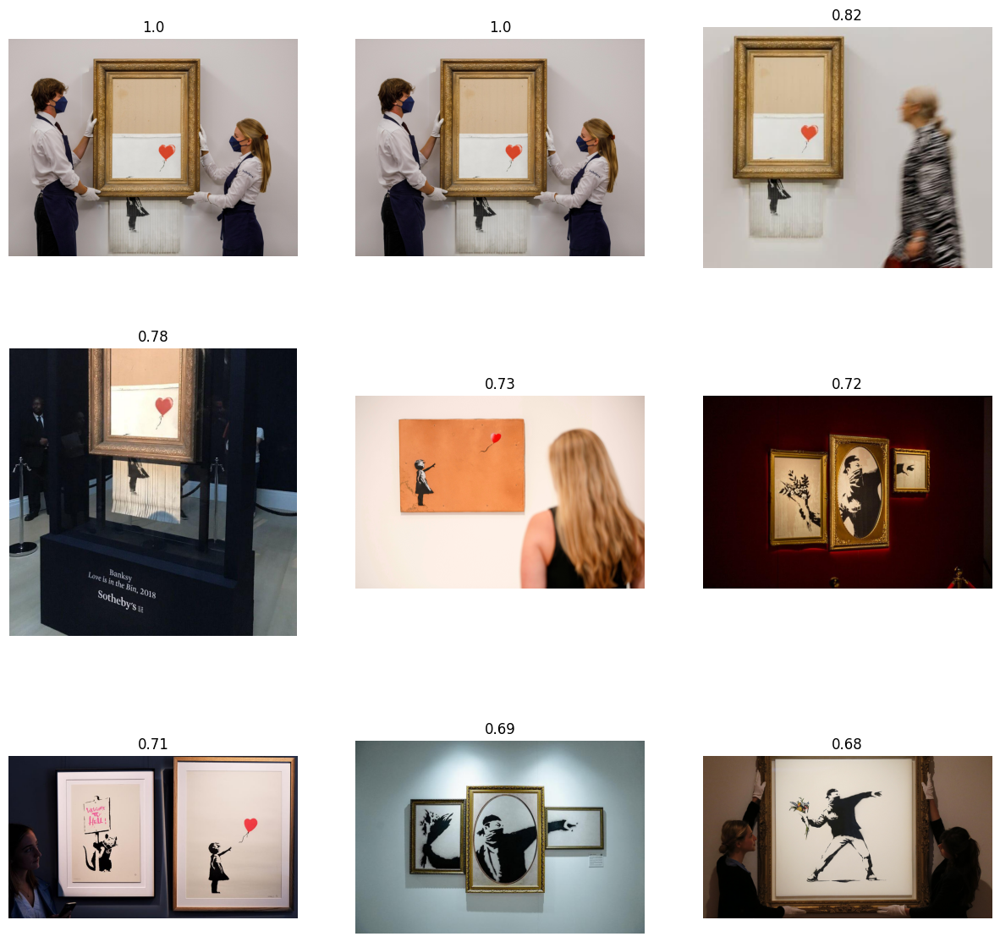

In [19]:
import skimage.io as io
import matplotlib.pyplot as plt


def plot_neighborhood(neighbors_row):
  """
    This function allows us to visualize the 9 nearest neighbors of every image in
    the dataset.
    We see the cosine similarity between the query image and its neighbors
    in the title of each plot.
  """
  f, axarr = plt.subplots(3,3, figsize=(15,15))

  axarr[0][0].imshow(io.imread(folder_path /'paintings' / neighbors_row[0][0]))
  axarr[0][1].imshow(io.imread(folder_path /'paintings' / neighbors_row[1][0]))
  axarr[0][2].imshow(io.imread(folder_path /'paintings' / neighbors_row[2][0]))
  axarr[1][0].imshow(io.imread(folder_path /'paintings' / neighbors_row[3][0]))
  axarr[1][1].imshow(io.imread(folder_path /'paintings' / neighbors_row[4][0]))
  axarr[1][2].imshow(io.imread(folder_path /'paintings' / neighbors_row[5][0]))
  axarr[2][0].imshow(io.imread(folder_path /'paintings' / neighbors_row[6][0]))
  axarr[2][1].imshow(io.imread(folder_path /'paintings' / neighbors_row[7][0]))
  axarr[2][2].imshow(io.imread(folder_path /'paintings' / neighbors_row[8][0]))

  axarr[0, 0].set_title(neighbors_row[0][1])
  axarr[0, 1].set_title(neighbors_row[1][1])
  axarr[0, 2].set_title(neighbors_row[2][1])
  axarr[1, 0].set_title(neighbors_row[3][1])
  axarr[1, 1].set_title(neighbors_row[4][1])
  axarr[1, 2].set_title(neighbors_row[5][1])
  axarr[2, 0].set_title(neighbors_row[6][1])
  axarr[2, 1].set_title(neighbors_row[7][1])
  axarr[2, 2].set_title(neighbors_row[8][1])

  for i in range(3):
        for j in range(3):
            axarr[i, j].axis('off')

plot_neighborhood(neighborhoods_dict[paintings_with_full_path[0]])

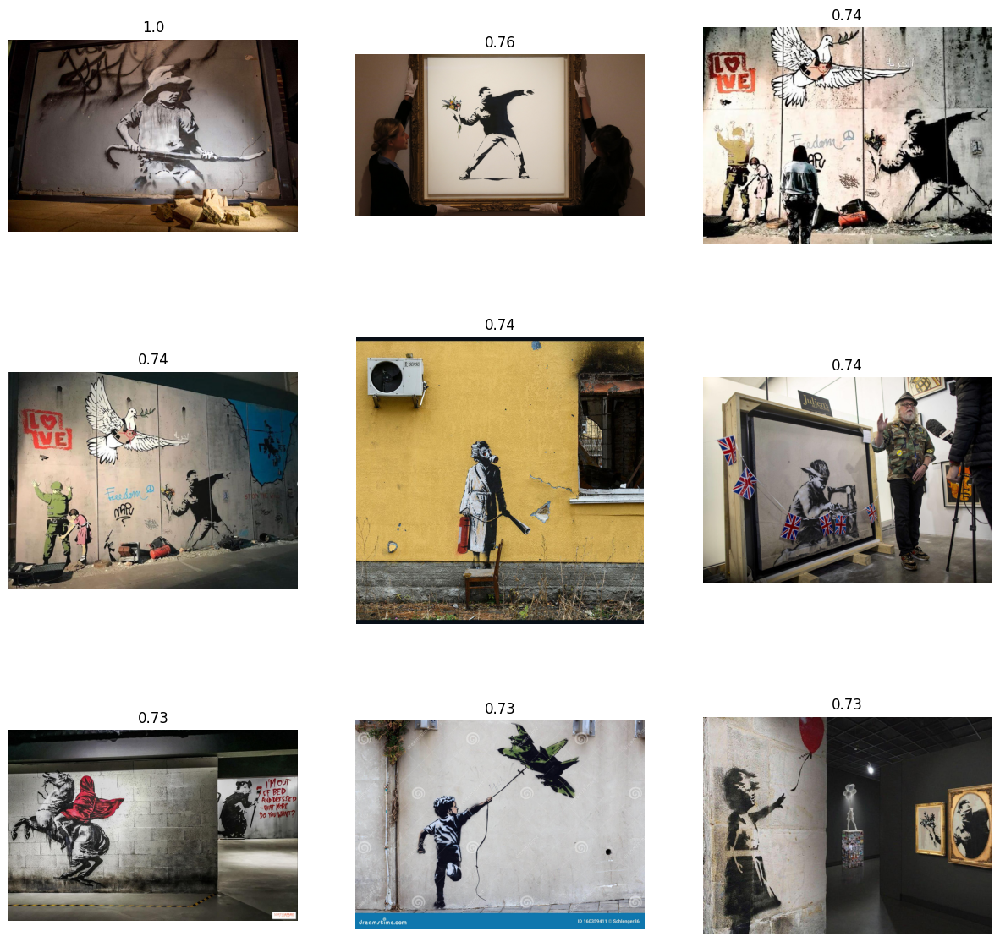

In [20]:
# @title Visualizing Image Neighborhoods with a Slider Widget {run:'auto'}

slider_value = 223  #@param {type: "slider", min: 0, max: 317}
plot_neighborhood(neighborhoods_dict[paintings_with_full_path[slider_value]])


## Clustering Images

Here we work with the K-medoids algorithm to select the most representative images in the dataset.

In [21]:
!pip install scikit-learn-extra

     ━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━ 2.0/2.0 MB 9.2 MB/s eta 0:00:00


In [22]:
from sklearn_extra.cluster import KMedoids


kmedoids = KMedoids(n_clusters=10, random_state=0,
                    init='k-medoids++', metric='cosine')

kmedoids.fit(X)

KMedoids(init='k-medoids++', metric='cosine', n_clusters=10, random_state=0)

In [23]:
# Here we get the medoid images (representatives) and the number of images
# that are most similar to them
image_clusters = dict(zip(images, kmedoids.labels_))
image_clusters

{PosixPath('/gdrive/MyDrive/art_recommendation/banksy/paintings/banksy_1.jpg'): 0,
 PosixPath('/gdrive/MyDrive/art_recommendation/banksy/paintings/banksy_02.jpg'): 1,
 PosixPath('/gdrive/MyDrive/art_recommendation/banksy/paintings/banksy_04.jpg'): 0,
 PosixPath('/gdrive/MyDrive/art_recommendation/banksy/paintings/banksy_05.jpg'): 9,
 PosixPath('/gdrive/MyDrive/art_recommendation/banksy/paintings/banksy_06.jpg'): 5,
 PosixPath('/gdrive/MyDrive/art_recommendation/banksy/paintings/banksy_07.jpg'): 8,
 PosixPath('/gdrive/MyDrive/art_recommendation/banksy/paintings/banksy_08.jpg'): 9,
 PosixPath('/gdrive/MyDrive/art_recommendation/banksy/paintings/banksy_010.jpg'): 1,
 PosixPath('/gdrive/MyDrive/art_recommendation/banksy/paintings/banksy_011.jpg'): 0,
 PosixPath('/gdrive/MyDrive/art_recommendation/banksy/paintings/banksy_012.jpg'): 7,
 PosixPath('/gdrive/MyDrive/art_recommendation/banksy/paintings/banksy_013.jpg'): 8,
 PosixPath('/gdrive/MyDrive/art_recommendation/banksy/paintings/banksy_01

## 8. Additional Clustering and Visualization

This part of the notebook contains additional code related to clustering and visualization of images. It includes techniques such as k-medoids clustering and visualizing clusters of similar images.

In [24]:
representative_images = []
representative_embeddings = []
cluster_number_repr_images = []
for image, embedding in paintings_embeddings.items():

    for cluster_number, repr_embedding in enumerate(kmedoids.cluster_centers_):
        comparison = np.equal(repr_embedding, embedding)
        if comparison.all():
            representative_images.append(image)
            representative_embeddings.append(embedding)
            cluster_number_repr_images.append(cluster_number)

In [25]:
# Here we get the filenames of the most represe
representative_images

[PosixPath('/gdrive/MyDrive/art_recommendation/banksy/paintings/banksy_02.jpg'),
 PosixPath('/gdrive/MyDrive/art_recommendation/banksy/paintings/banksy_0125.jpg'),
 PosixPath('/gdrive/MyDrive/art_recommendation/banksy/paintings/banksy_0135.jpg'),
 PosixPath('/gdrive/MyDrive/art_recommendation/banksy/paintings/banksy_0136.jpg'),
 PosixPath('/gdrive/MyDrive/art_recommendation/banksy/paintings/banksy_0195.jpg'),
 PosixPath('/gdrive/MyDrive/art_recommendation/banksy/paintings/banksy_0213.jpg'),
 PosixPath('/gdrive/MyDrive/art_recommendation/banksy/paintings/banksy_0262.jpg'),
 PosixPath('/gdrive/MyDrive/art_recommendation/banksy/paintings/banksy_0292.jpg'),
 PosixPath('/gdrive/MyDrive/art_recommendation/banksy/paintings/banksy_0317.jpg'),
 PosixPath('/gdrive/MyDrive/art_recommendation/banksy/paintings/banksy_0352.jpg')]

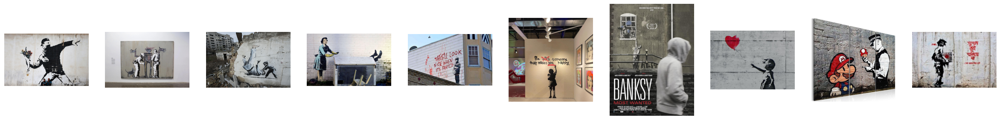

In [26]:
## Visualize representative images (medoids)
f, axarr = plt.subplots(1, 10, figsize=(30,30))

for i in range(10):
  axarr[i].imshow(io.imread(folder_path /'paintings' /  representative_images[i]))
  axarr[i].axis('off')

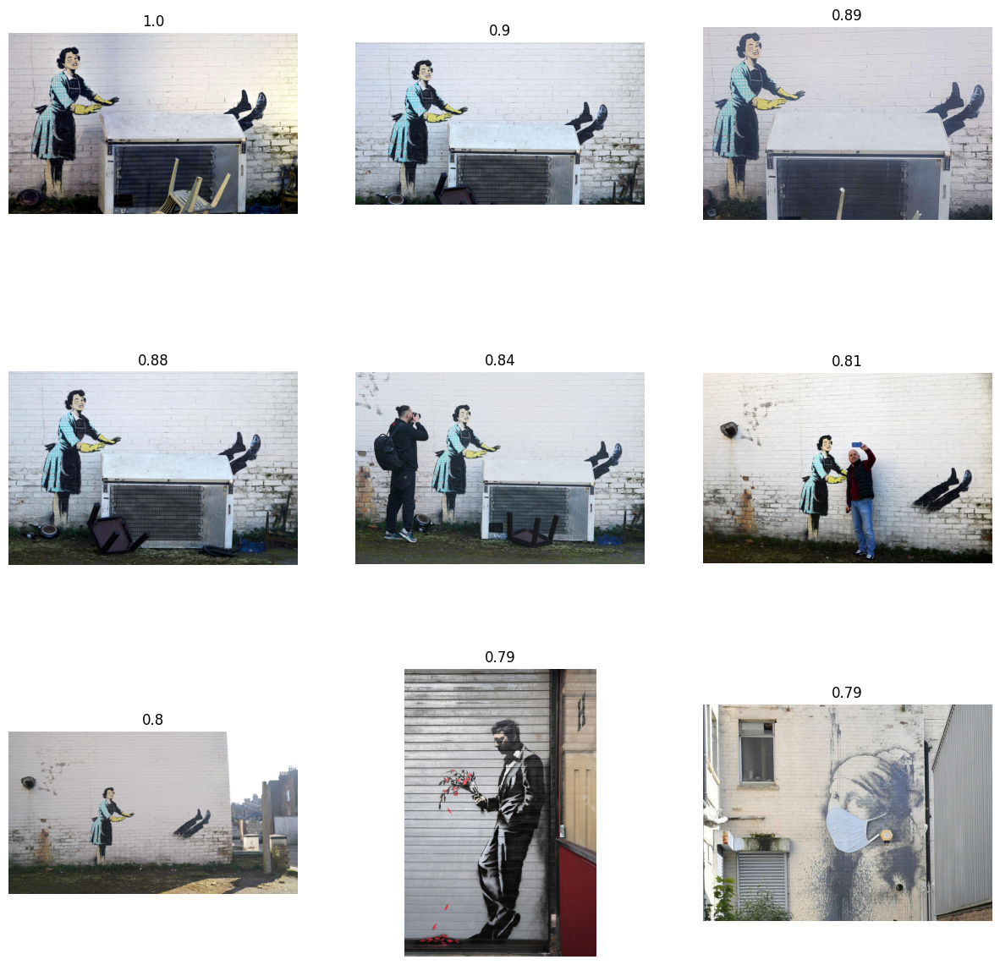

In [27]:
# @title Slider Tool to Visualize Every Neighborhood of the Ten Representative Images {run:'auto'}
# @markdown * Do these images have more duplicates?
# @markdown * Do you find them representative?
slider_value = 3  # @param {type: "slider", min: 0, max: 90}
plot_neighborhood(neighborhoods_dict[representative_images[slider_value]])



## Choosing an 'Optimal' Number of Clusters Based on the Elbow Method




Choosing the ""right"" number of clusters is useful for achieving meaningful clustering results. In this part, we analyze different clustering options using the elbow method. Selecting a small number of clusters helps to summarize the dataset and in forming interpretable groups of similar images.

We want to see find where the inflexion point happens.

* **Distortion:** It is calculated as the average of the squared distances from the cluster centers of the respective clusters.

* **Inertia:** It is the sum of squared distances of samples to their closest cluster center.


Both of these methods usually give similar results. Both plots should show a decrease in intertia or distortion as we increase the number of clusters. We use the soft rule of choosing the number of clusters where we see "an elbow" (a big inflection) in both of these curves.

In this set of plots, we see that the biggest inflection point happens at around 20 clusters, so it might be "good enough" to use 20 images to describe the dataset. **Think about this not as a hard rule, but as a heuristic to simplify and reduce the time of your explorations.**

Read more about this [here](https://www.geeksforgeeks.org/elbow-method-for-optimal-value-of-k-in-kmeans/).

In [28]:
from sklearn.cluster import KMeans
from sklearn_extra.cluster import KMedoids
from sklearn import metrics
from scipy.spatial.distance import cdist
import numpy as np
import matplotlib.pyplot as plt


distortions = []
inertias = []
mapping1 = {}
mapping2 = {}
K = range(5, 100, 2)

for k in K:
    kmedoidModel = KMedoids(n_clusters=k, random_state=0, init='k-medoids++',
                            metric='cosine')
    kmedoidModel.fit(X)

    distortions.append(sum(np.min(cdist(np.array(X), kmedoidModel.cluster_centers_,
                      'cosine'),axis=1)))
    inertias.append(kmedoidModel.inertia_)

    mapping1[k] = sum(np.min(cdist(np.array(X), kmedoidModel.cluster_centers_,
                 'cosine'),axis=1))
    mapping2[k] = kmedoidModel.inertia_

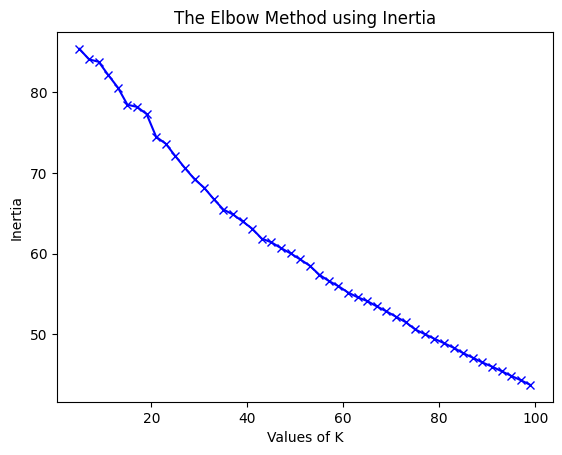

In [29]:
plt.plot(K, inertias, 'bx-')
plt.xlabel('Values of K')
plt.ylabel('Inertia')
plt.title('The Elbow Method using Inertia')
plt.show()

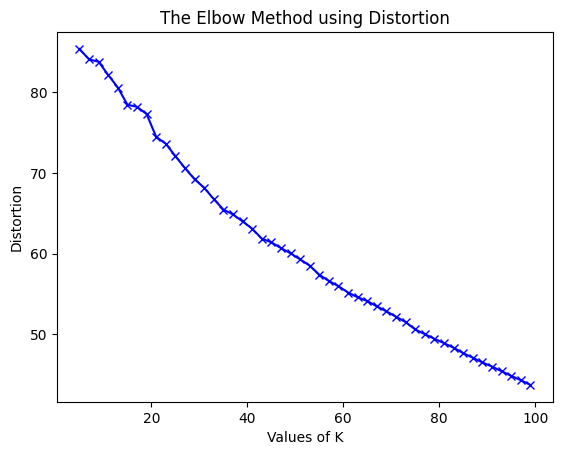

In [30]:
plt.plot(K, distortions, 'bx-')
plt.xlabel('Values of K')
plt.ylabel('Distortion')
plt.title('The Elbow Method using Distortion')
plt.show()